In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 17067, done.
remote: Counting objects: 100% (45/45), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 17067 (delta 24), reused 28 (delta 12), pack-reused 17022 (from 1)
Receiving objects: 100% (17067/17067), 15.68 MiB | 8.52 MiB/s, done.
Resolving deltas: 100% (11714/11714), done.
/content/yolov5


In [ ]:
!pip install -r requirements.txt


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 899.1/899.1 kB 56.8 MB/s eta 0:00:00


In [ ]:
# Create a new dataset configuration YAML file
with open('/content/yolov5/data.yaml', 'w') as f:
    f.write("""
train: /content/drive/MyDrive/YOLO_Project/BottleDataset/train/images
val: /content/drive/MyDrive/YOLO_Project/BottleDataset/valid/images
test: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images
nc: 1  # Number of classes
names: ['bottle']  # List of class names
""")


In [ ]:
!python3 /content/yolov5/train.py --img 320 --batch-size 16 --epochs 40 --data /content/yolov5/data.yaml --weights yolov5n.pt --device 0 --save-period 1 --project /content/yolov5/runs/train --name save

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
      22/39     0.606G    0.03056    0.01677          0         42        320:  25% 34/138 [00:04<00:18,  5.56it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      22/39     0.606G    0.03049    0.01677          0         53        320:  25% 34/138 [00:04<00:18,  5.56it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
      22/39     0.606G    0.03051    0.01677          0         54        320:  26% 36/138 [00:04<00:15,  6.65it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp

In [ ]:
from models.common import DetectMultiBackend
import torch
import torch.nn as nn
import torch.nn.utils.prune as prune
checkpoint_path = "/content/yolov5/runs/train/save2/weights/best.pt"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
checkpoint = torch.load(checkpoint_path, map_location=device)
model = DetectMultiBackend(checkpoint_path, device=device)
def prune_model(model, amount=0.3):
    for name, module in model.model.named_modules():
        if isinstance(module, nn.Conv2d):
            prune.ln_structured(module, name="weight", amount=amount, n=2, dim=0)
            prune.remove(module, "weight")
    print(f"Pruned model with amount: {amount}")
prune_model(model, amount=0.3)
pruned_model_path = "/content/yolov5/runs/train/save2/weights/pruned_model.pt"
torch.save({
    "model": checkpoint["model"],
    "state_dict": model.state_dict(),
    "epoch": checkpoint.get("epoch", None),
    "optimizer": checkpoint.get("optimizer", None),
    "opt": checkpoint.get("opt", None),
}, pruned_model_path)
print(f"Pruned model saved to {pruned_model_path}")


Fusing layers... 


Checkpoint Keys: dict_keys(['epoch', 'best_fitness', 'model', 'ema', 'updates', 'optimizer', 'opt', 'git', 'date'])


Model summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs


Pruned model with amount: 0.3
Pruned model saved to /content/yolov5/runs/train/save2/weights/pruned_model.pt


In [ ]:
!python3 train.py \
    --img 320 \
    --batch-size 16 \
    --epochs 3 \
    --data /content/yolov5/data.yaml \
    --weights /content/yolov5/runs/train/save2/weights/pruned_model.pt \
    --project /content/yolov5/runs/train \
    --name fine_tune \
    --device 0


wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2024-12-04 21:56:32.390525: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-04 21:56:32.411325: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-04 21:56:32.417700: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visua

In [ ]:
!python3 val.py --weights /content/yolov5/runs/train/fine_tune/weights/best.pt --data /content/yolov5/data.yaml --img 320 --device 0

val: data=/content/yolov5/data.yaml, weights=['/content/yolov5/runs/train/fine_tune/weights/best.pt'], batch_size=32, imgsz=320, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)

Fusing layers... 
Model summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
val: Scanning /content/drive/MyDrive/YOLO_Project/BottleDataset/valid/labels.cache... 172 images, 1 backgrounds, 0 corrupt: 100% 172/172 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 6/6 [00:03<00:00,  1.77it/s]
                   all        172        278      0.927      0.909      0.948      0.675
Speed: 0.1ms pre-process, 3.2ms inference, 5.8ms NMS

In [ ]:
!python3 /content/yolov5/detect.py --weights /content/yolov5/runs/train/fine_tune/weights/best.pt --img 320 --source /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images

detect: weights=['/content/yolov5/runs/train/fine_tune/weights/best.pt'], source=/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)

Fusing layers... 
Model summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/93 /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0008_jpg.rf.aaa42e83cab7d3868f7826692961d96a.jpg: 320x192 1 bottle, 38.5ms
image 2/93 /content/drive/MyDrive/YOLO_Project/B

In [ ]:
!python3 /content/yolov5/export.py --weights /content/yolov5/runs/train/fine_tune/weights/best.pt --img-size 320 --include tflite

export: data=data/coco128.yaml, weights=['/content/yolov5/runs/train/fine_tune/weights/best.pt'], imgsz=[320], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, per_tensor=False, dynamic=False, cache=, simplify=False, mlmodel=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['tflite']
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs

PyTorch: starting from /content/yolov5/runs/train/fine_tune/weights/best.pt with output shape (1, 6300, 6) (3.6 MB)
2024-12-04 22:04:08.869492: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-04 22:04:08.890215: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:

Output Details: [{'name': 'StatefulPartitionedCall_1:0', 'index': 532, 'shape': array([   1, 6300,    6], dtype=int32), 'shape_signature': array([   1, 6300,    6], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]


  0%|          | 0/20 [00:00<?, ?it/s]

Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle34_jpg.rf.6d888f45e611bfb255ee5029cc72ad99.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=640, height=640
Filtered Detections (Confidence > 0.5): 11
Detection: {'x': 312.88318634033203, 'y': 333.9775848388672, 'w': 395.2193069458008, 'h': 460.23902893066406, 'confidence': 0.794741, 'class_id': 0}
Detection: {'x': 316.5005683898926, 'y': 339.39361572265625, 'w': 384.7865295410156, 'h': 459.2570114135742, 'confidence': 0.61631966, 'class_id': 0}
Detection: {'x': 308.4789276123047, 'y': 325.8347702026367, 'w': 409.92862701416016, 'h': 458.71387481689453, 'confidence': 0.8143567, 'class_id': 0}
Detection: {'x': 307.51285552978516, 'y': 325.01731872558594, 'w': 406.6743850708008, 'h': 457.8125762939453, 'confidence': 0.8066842, 'class_id': 0}
Detection: {'x': 308.5402488708496, 'y': 325.61065673828125, 'w': 406.788330078125, 'h': 462.43621826171875, 'confidence': 0.793372, 

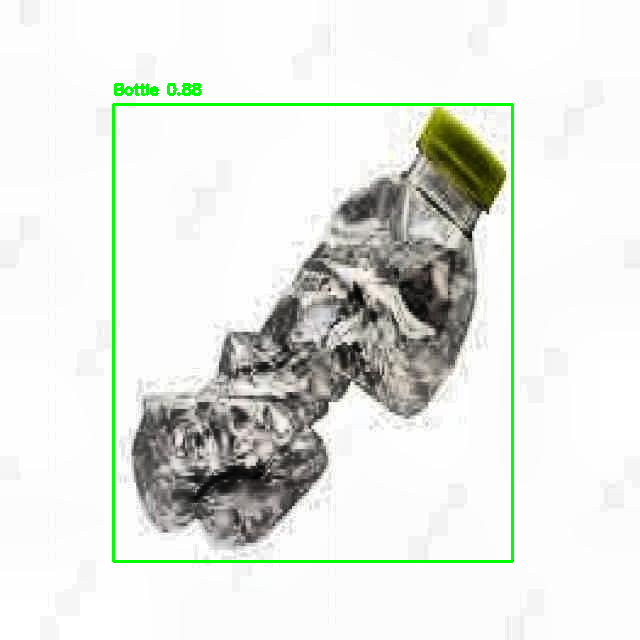

  5%|▌         | 1/20 [00:00<00:02,  8.15it/s]

Output saved to: output_crushed_plastic_bottle34_jpg.rf.6d888f45e611bfb255ee5029cc72ad99.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle35_jpg.rf.8d788209b6cc921c0501b6abc90460c7.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 37
Detection: {'x': 44.79736648499966, 'y': 109.55052226781845, 'w': 86.37709468603134, 'h': 208.98408740758896, 'confidence': 0.8960476, 'class_id': 0}
Detection: {'x': 44.48097310960293, 'y': 109.25590172410011, 'w': 88.24249058961868, 'h': 205.71045130491257, 'confidence': 0.87518096, 'class_id': 0}
Detection: {'x': 189.52804058790207, 'y': 114.09583389759064, 'w': 66.78772866725922, 'h': 121.06102108955383, 'confidence': 0.73328924, 'class_id': 0}
Detection: {'x': 189.55090641975403, 'y': 113.48905116319656, 'w': 66.55965372920036, 'h': 117.1847864985466, 'confidence': 0.5842291, 'class_id': 0}
Detection: {'x': 189.53344523906708,

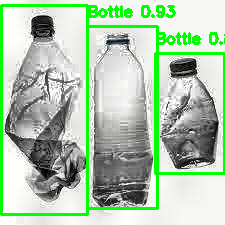

 10%|█         | 2/20 [00:01<00:10,  1.66it/s]

Output saved to: output_crushed_plastic_bottle35_jpg.rf.8d788209b6cc921c0501b6abc90460c7.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/IMG_2382_23_11zon_jpg.rf.ba9f388a8a610a6c3c2a985e6c0a28f5.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=240, height=320
Filtered Detections (Confidence > 0.5): 2
Detection: {'x': 72.7460503578186, 'y': 194.27396774291992, 'w': 132.55353927612305, 'h': 82.73869514465332, 'confidence': 0.5673892, 'class_id': 0}
Detection: {'x': 72.42675304412842, 'y': 194.38100814819336, 'w': 132.551851272583, 'h': 83.7108325958252, 'confidence': 0.5590899, 'class_id': 0}
Detections After NMS: 1
NMS Detection: {'x': 72.7460503578186, 'y': 194.27396774291992, 'w': 132.55353927612305, 'h': 82.73869514465332, 'confidence': 0.5673892, 'class_id': 0}
Bottles detected in image: 1


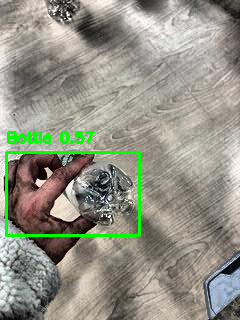

 15%|█▌        | 3/20 [00:02<00:13,  1.27it/s]

Output saved to: output_IMG_2382_23_11zon_jpg.rf.ba9f388a8a610a6c3c2a985e6c0a28f5.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-54-_jpeg.rf.d909654ec9016e20d64ba0b10241102a.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 0
Detections After NMS: 0
No detections found for image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-54-_jpeg.rf.d909654ec9016e20d64ba0b10241102a.jpg


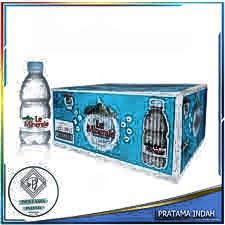

 20%|██        | 4/20 [00:02<00:13,  1.22it/s]

Output saved to: output_images-54-_jpeg.rf.d909654ec9016e20d64ba0b10241102a.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-2024-04-11T000625-863_jpeg.rf.d8cfeff8df5b72514b42d1db168624e1.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 12
Detection: {'x': 117.15213060379028, 'y': 113.74324411153793, 'w': 111.90737932920456, 'h': 188.83305341005325, 'confidence': 0.59301186, 'class_id': 0}
Detection: {'x': 113.46758008003235, 'y': 116.29941612482071, 'w': 104.90110069513321, 'h': 192.23987460136414, 'confidence': 0.57081234, 'class_id': 0}
Detection: {'x': 118.42896938323975, 'y': 116.15759432315826, 'w': 102.24677994847298, 'h': 197.10073471069336, 'confidence': 0.77870667, 'class_id': 0}
Detection: {'x': 117.82535165548325, 'y': 117.5201565027237, 'w': 111.36954948306084, 'h': 195.70707231760025, 'confidence': 0.646403, 'class_id': 0}
Detection: {'x': 117.71251112222672, '

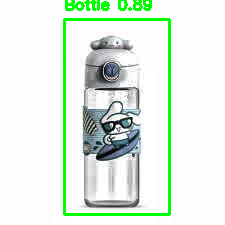

 25%|██▌       | 5/20 [00:03<00:12,  1.18it/s]

Output saved to: output_images-2024-04-11T000625-863_jpeg.rf.d8cfeff8df5b72514b42d1db168624e1.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-40-_jpeg.rf.eb1f899a7f25280a76914a654370f28e.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 16
Detection: {'x': 167.8139492869377, 'y': 97.0202274620533, 'w': 26.97726096957922, 'h': 75.22247806191444, 'confidence': 0.86941755, 'class_id': 0}
Detection: {'x': 168.64320784807205, 'y': 97.37084582448006, 'w': 26.581635139882565, 'h': 74.34263974428177, 'confidence': 0.7578568, 'class_id': 0}
Detection: {'x': 168.29186528921127, 'y': 96.77994176745415, 'w': 28.960105776786804, 'h': 75.0763513147831, 'confidence': 0.8494596, 'class_id': 0}
Detection: {'x': 168.41739267110825, 'y': 96.74520045518875, 'w': 29.08225692808628, 'h': 75.11789202690125, 'confidence': 0.85744876, 'class_id': 0}
Detection: {'x': 168.42762529850006, 'y': 96.73239

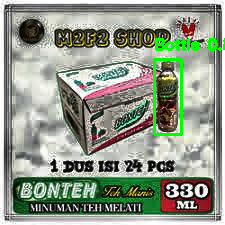

 30%|███       | 6/20 [00:04<00:12,  1.15it/s]

Output saved to: output_images-40-_jpeg.rf.eb1f899a7f25280a76914a654370f28e.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/cropped_pb_241_jpg.rf.632da1b7bcc5d39f692a0d5b18a72528.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=585, height=1000
Filtered Detections (Confidence > 0.5): 15
Detection: {'x': 309.8463150858879, 'y': 461.58456802368164, 'w': 198.70159909129143, 'h': 600.5104780197144, 'confidence': 0.7280047, 'class_id': 0}
Detection: {'x': 309.7810059785843, 'y': 462.7266526222229, 'w': 199.9157452583313, 'h': 597.7625846862793, 'confidence': 0.7355004, 'class_id': 0}
Detection: {'x': 308.6477726697922, 'y': 464.8423492908478, 'w': 197.74410411715508, 'h': 593.9711332321167, 'confidence': 0.8620128, 'class_id': 0}
Detection: {'x': 309.29667949676514, 'y': 462.9599153995514, 'w': 200.2308887243271, 'h': 590.9348130226135, 'confidence': 0.9001008, 'class_id': 0}
Detection: {'x': 312.4143612384796, 'y': 462.8649055957794, 'w': 

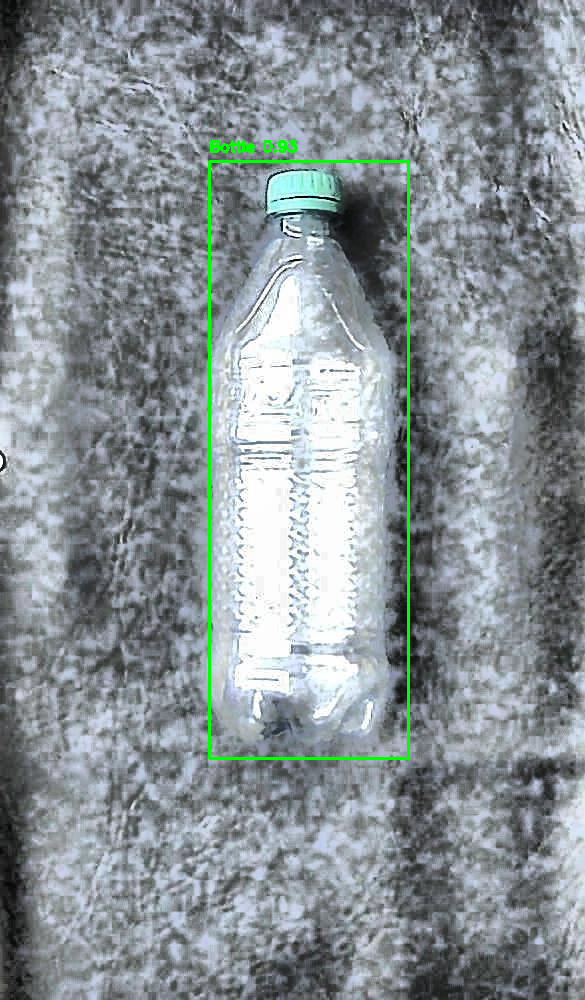

 35%|███▌      | 7/20 [00:05<00:11,  1.10it/s]

Output saved to: output_cropped_pb_241_jpg.rf.632da1b7bcc5d39f692a0d5b18a72528.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-51-_jpeg.rf.21e73b52c2416f361859110bf48bd859.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 21
Detection: {'x': 160.9040692448616, 'y': 140.60280472040176, 'w': 51.08996294438839, 'h': 173.71110767126083, 'confidence': 0.5330328, 'class_id': 0}
Detection: {'x': 88.56750056147575, 'y': 155.28332591056824, 'w': 37.29997202754021, 'h': 139.56787437200546, 'confidence': 0.632945, 'class_id': 0}
Detection: {'x': 88.60782086849213, 'y': 155.50101399421692, 'w': 37.35815919935703, 'h': 139.98710364103317, 'confidence': 0.5533824, 'class_id': 0}
Detection: {'x': 89.27566409111023, 'y': 154.60303723812103, 'w': 37.964023277163506, 'h': 141.990365087986, 'confidence': 0.6572695, 'class_id': 0}
Detection: {'x': 89.21668902039528, 'y': 154.69635128974915, 'w'

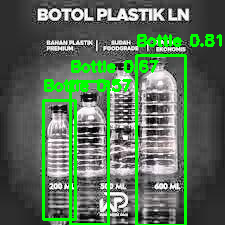

 40%|████      | 8/20 [00:06<00:10,  1.19it/s]

Output saved to: output_images-51-_jpeg.rf.21e73b52c2416f361859110bf48bd859.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle76_jpg.rf.23268fc6cae8ccaaf701d638bcacaf32.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=640, height=640
Filtered Detections (Confidence > 0.5): 6
Detection: {'x': 316.60560607910156, 'y': 356.10084533691406, 'w': 480.5296325683594, 'h': 512.2100067138672, 'confidence': 0.96156746, 'class_id': 0}
Detection: {'x': 316.72828674316406, 'y': 355.2463912963867, 'w': 476.5216827392578, 'h': 511.9305419921875, 'confidence': 0.9584695, 'class_id': 0}
Detection: {'x': 317.1918296813965, 'y': 355.17051696777344, 'w': 473.86600494384766, 'h': 520.1493453979492, 'confidence': 0.9534628, 'class_id': 0}
Detection: {'x': 314.6222114562988, 'y': 355.89599609375, 'w': 479.61963653564453, 'h': 526.1649703979492, 'confidence': 0.95027643, 'class_id': 0}
Detection: {'x': 315.3795051574707, 'y': 356.1124420166

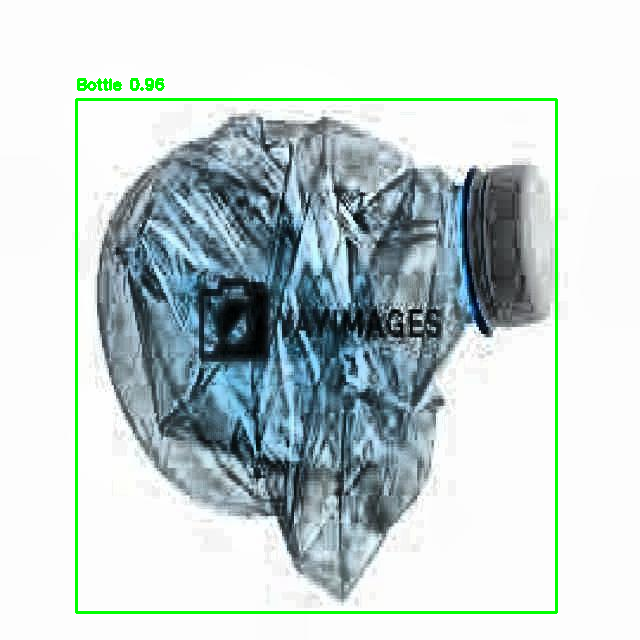

 45%|████▌     | 9/20 [00:07<00:09,  1.15it/s]

Output saved to: output_crushed_plastic_bottle76_jpg.rf.23268fc6cae8ccaaf701d638bcacaf32.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0045_jpg.rf.7dd066c695fe0caf4a30f68196d97f34.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=1080, height=1920
Filtered Detections (Confidence > 0.5): 11
Detection: {'x': 510.4440951347351, 'y': 938.0098342895508, 'w': 552.2228264808655, 'h': 1382.6046752929688, 'confidence': 0.95940083, 'class_id': 0}
Detection: {'x': 513.7058436870575, 'y': 943.2670211791992, 'w': 558.3373618125916, 'h': 1372.342300415039, 'confidence': 0.8380171, 'class_id': 0}
Detection: {'x': 510.1461124420166, 'y': 942.9291343688965, 'w': 530.9866511821747, 'h': 1395.7423782348633, 'confidence': 0.93351316, 'class_id': 0}
Detection: {'x': 509.2677104473114, 'y': 942.2763633728027, 'w': 524.8334276676178, 'h': 1397.1673965454102, 'confidence': 0.9297323, 'class_id': 0}
Detection: {'x': 508.69965076446533, 'y': 944.099006652832, 

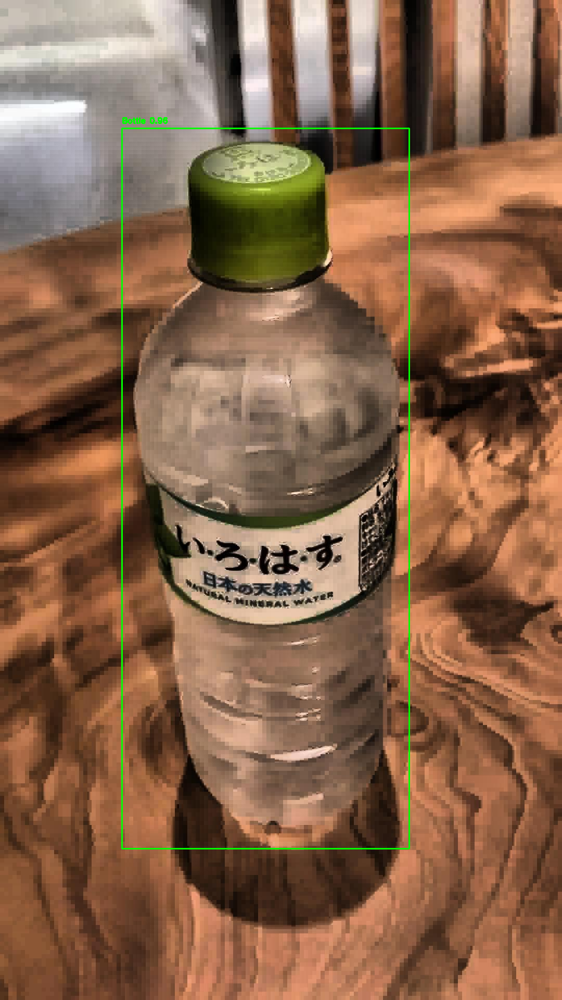

 50%|█████     | 10/20 [00:08<00:08,  1.13it/s]

Output saved to: output_0045_jpg.rf.7dd066c695fe0caf4a30f68196d97f34.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/IMG_2389_30_11zon_jpg.rf.7057dea01b10d00c00d5bdf37adc55e3.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=240, height=320
Filtered Detections (Confidence > 0.5): 10
Detection: {'x': 105.69901943206787, 'y': 167.76758193969727, 'w': 63.607378005981445, 'h': 204.58429336547852, 'confidence': 0.94871855, 'class_id': 0}
Detection: {'x': 105.74267148971558, 'y': 166.75724029541016, 'w': 63.57849597930908, 'h': 200.54780960083008, 'confidence': 0.9369575, 'class_id': 0}
Detection: {'x': 104.28364276885986, 'y': 166.51567459106445, 'w': 63.96820306777954, 'h': 201.70700073242188, 'confidence': 0.8934905, 'class_id': 0}
Detection: {'x': 104.24177885055542, 'y': 165.45419692993164, 'w': 64.5061182975769, 'h': 199.99868392944336, 'confidence': 0.86128235, 'class_id': 0}
Detection: {'x': 105.45817136764526, 'y': 165.85033416748047

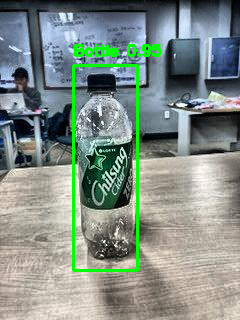

 55%|█████▌    | 11/20 [00:08<00:07,  1.21it/s]

Output saved to: output_IMG_2389_30_11zon_jpg.rf.7057dea01b10d00c00d5bdf37adc55e3.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/2020-02-04-05_28_31-855255_jpg.rf.ceaa10fd73a4740943921ec257588f4c.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=640, height=640
Filtered Detections (Confidence > 0.5): 10
Detection: {'x': 320.22422790527344, 'y': 357.00401306152344, 'w': 190.54931640625, 'h': 550.8037948608398, 'confidence': 0.61267805, 'class_id': 0}
Detection: {'x': 322.5244140625, 'y': 356.9243621826172, 'w': 186.93609237670898, 'h': 553.284797668457, 'confidence': 0.65114224, 'class_id': 0}
Detection: {'x': 323.90586853027344, 'y': 353.06507110595703, 'w': 188.7240982055664, 'h': 556.2184906005859, 'confidence': 0.6784136, 'class_id': 0}
Detection: {'x': 323.6178207397461, 'y': 354.84371185302734, 'w': 186.49595260620117, 'h': 559.9033737182617, 'confidence': 0.76693916, 'class_id': 0}
Detection: {'x': 321.5557098388672, 'y': 355.555

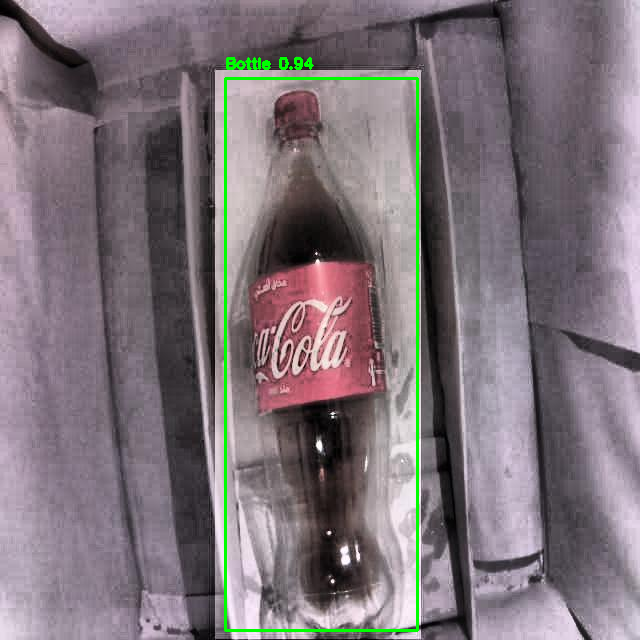

 60%|██████    | 12/20 [00:09<00:06,  1.25it/s]

Output saved to: output_2020-02-04-05_28_31-855255_jpg.rf.ceaa10fd73a4740943921ec257588f4c.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-2024-04-11T000629-502_jpeg.rf.dacd2cc48adbca6539e054dcc0cdcdc1.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=225, height=225
Filtered Detections (Confidence > 0.5): 11
Detection: {'x': 154.25381362438202, 'y': 108.24581533670425, 'w': 66.1542646586895, 'h': 197.97728061676025, 'confidence': 0.9312107, 'class_id': 0}
Detection: {'x': 154.74556982517242, 'y': 107.08862990140915, 'w': 64.92534354329109, 'h': 198.13445806503296, 'confidence': 0.76679873, 'class_id': 0}
Detection: {'x': 153.5906508564949, 'y': 108.12666490674019, 'w': 69.78631764650345, 'h': 199.0736871957779, 'confidence': 0.9138746, 'class_id': 0}
Detection: {'x': 153.44499349594116, 'y': 108.16880911588669, 'w': 68.48604306578636, 'h': 197.8435456752777, 'confidence': 0.9160168, 'class_id': 0}
Detection: {'x': 152.8918951749

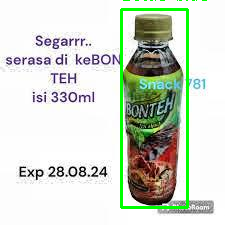

 65%|██████▌   | 13/20 [00:10<00:05,  1.34it/s]

Output saved to: output_images-2024-04-11T000629-502_jpeg.rf.dacd2cc48adbca6539e054dcc0cdcdc1.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle08_jpg.rf.452db11b41d26f2eb5dc61bc8f966397.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=640, height=640
Filtered Detections (Confidence > 0.5): 10
Detection: {'x': 418.95923614501953, 'y': 298.0075263977051, 'w': 179.3799591064453, 'h': 415.92872619628906, 'confidence': 0.5597218, 'class_id': 0}
Detection: {'x': 420.40061950683594, 'y': 297.9814338684082, 'w': 177.42454528808594, 'h': 419.4187545776367, 'confidence': 0.5540824, 'class_id': 0}
Detection: {'x': 426.3577651977539, 'y': 293.6286163330078, 'w': 190.5034637451172, 'h': 422.39830017089844, 'confidence': 0.6654328, 'class_id': 0}
Detection: {'x': 427.49290466308594, 'y': 292.24056243896484, 'w': 189.8767852783203, 'h': 420.9645080566406, 'confidence': 0.740234, 'class_id': 0}
Detection: {'x': 425.5280303955078, 

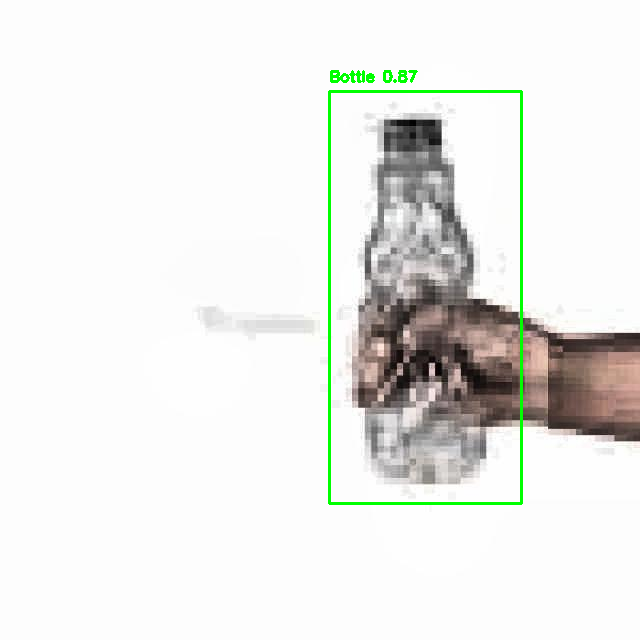

 70%|███████   | 14/20 [00:11<00:04,  1.23it/s]

Output saved to: output_crushed_plastic_bottle08_jpg.rf.452db11b41d26f2eb5dc61bc8f966397.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/cropped_pb_219_jpg.rf.15412e450b9283a4d267f9b62681dac7.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=585, height=1000
Filtered Detections (Confidence > 0.5): 13
Detection: {'x': 306.60359412431717, 'y': 460.7491195201874, 'w': 192.84946024417877, 'h': 607.6622009277344, 'confidence': 0.8199867, 'class_id': 0}
Detection: {'x': 306.46736204624176, 'y': 461.38325333595276, 'w': 192.08923503756523, 'h': 604.0012240409851, 'confidence': 0.79254866, 'class_id': 0}
Detection: {'x': 304.95039850473404, 'y': 462.8336727619171, 'w': 191.89006492495537, 'h': 603.540301322937, 'confidence': 0.9033041, 'class_id': 0}
Detection: {'x': 305.66220849752426, 'y': 460.92745661735535, 'w': 193.43621358275414, 'h': 598.8719463348389, 'confidence': 0.9106085, 'class_id': 0}
Detection: {'x': 306.7790535092354, 'y': 454.9

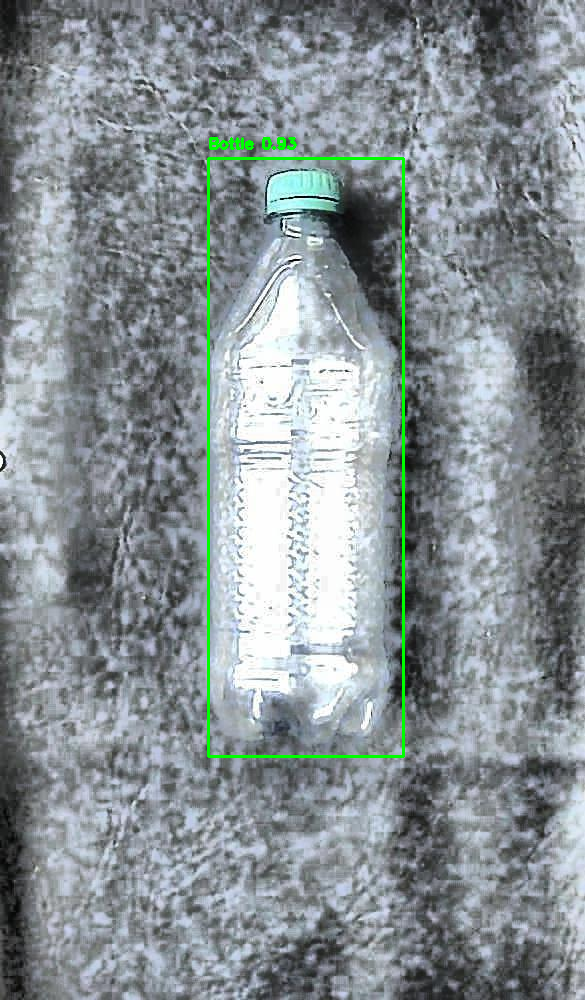

 75%|███████▌  | 15/20 [00:12<00:04,  1.24it/s]

Output saved to: output_cropped_pb_219_jpg.rf.15412e450b9283a4d267f9b62681dac7.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0060_jpg.rf.9461bab32d4033af095aa9aac954bb34.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=1080, height=1920
Filtered Detections (Confidence > 0.5): 10
Detection: {'x': 569.2984771728516, 'y': 1125.223045349121, 'w': 593.5785627365112, 'h': 803.8829040527344, 'confidence': 0.6865311, 'class_id': 0}
Detection: {'x': 569.0935778617859, 'y': 1134.938735961914, 'w': 595.2794909477234, 'h': 812.7620887756348, 'confidence': 0.6523233, 'class_id': 0}
Detection: {'x': 574.2373037338257, 'y': 1185.578842163086, 'w': 601.6201686859131, 'h': 941.0286140441895, 'confidence': 0.5690677, 'class_id': 0}
Detection: {'x': 571.0613322257996, 'y': 1195.5196380615234, 'w': 601.2959218025208, 'h': 936.716423034668, 'confidence': 0.57140636, 'class_id': 0}
Detection: {'x': 577.6150846481323, 'y': 1173.9738464355469, 'w': 611.1055

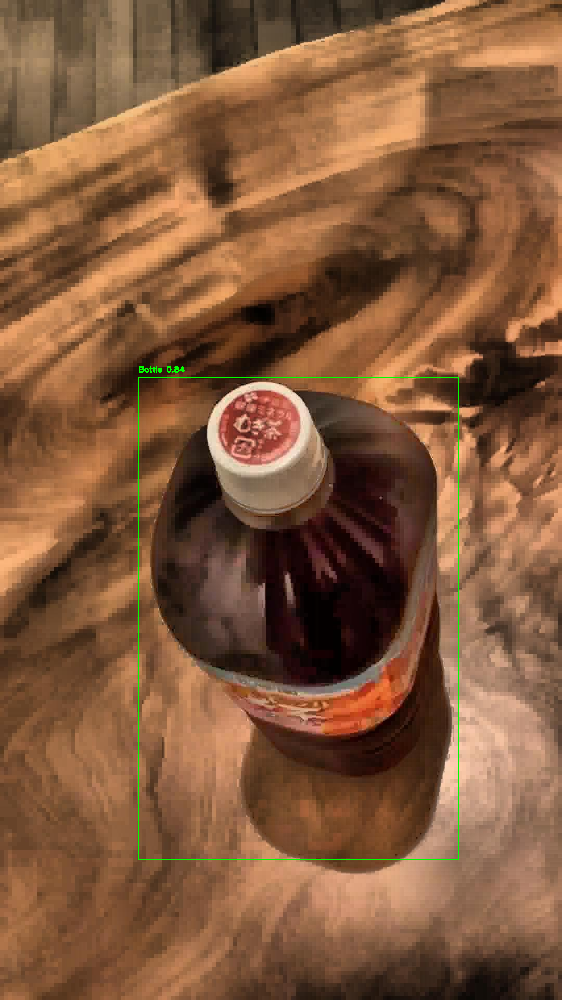

 80%|████████  | 16/20 [00:13<00:03,  1.13it/s]

Output saved to: output_0060_jpg.rf.9461bab32d4033af095aa9aac954bb34.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/image2020-02-18-01_35_13-938750_jpg.rf.6a601a1b009ffddd9ef05a82509771f9.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=1024, height=768
Filtered Detections (Confidence > 0.5): 15
Detection: {'x': 142.8353271484375, 'y': 354.5969009399414, 'w': 165.21726989746094, 'h': 348.6346206665039, 'confidence': 0.57293487, 'class_id': 0}
Detection: {'x': 142.39495849609375, 'y': 354.5050735473633, 'w': 168.9320068359375, 'h': 344.48052978515625, 'confidence': 0.5713248, 'class_id': 0}
Detection: {'x': 142.8585205078125, 'y': 355.2697219848633, 'w': 167.90435791015625, 'h': 345.70660400390625, 'confidence': 0.5691018, 'class_id': 0}
Detection: {'x': 145.10374450683594, 'y': 357.5093994140625, 'w': 168.34893798828125, 'h': 350.0540313720703, 'confidence': 0.8450212, 'class_id': 0}
Detection: {'x': 145.6436767578125, 'y': 357.585342

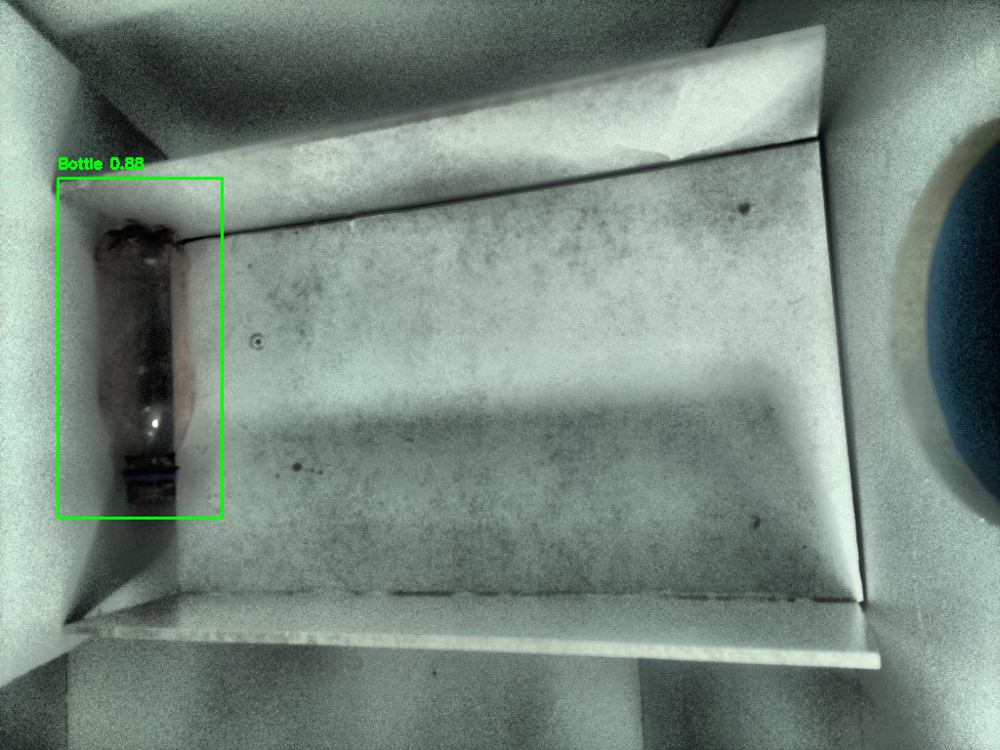

 85%|████████▌ | 17/20 [00:13<00:02,  1.17it/s]

Output saved to: output_image2020-02-18-01_35_13-938750_jpg.rf.6a601a1b009ffddd9ef05a82509771f9.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0024_jpg.rf.64464243965365d6dd83848ef8c2f0a6.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=1080, height=1920
Filtered Detections (Confidence > 0.5): 12
Detection: {'x': 461.6203486919403, 'y': 787.4875259399414, 'w': 552.8025698661804, 'h': 1487.6487350463867, 'confidence': 0.8864207, 'class_id': 0}
Detection: {'x': 467.8015422821045, 'y': 791.2494277954102, 'w': 550.2327990531921, 'h': 1469.0350341796875, 'confidence': 0.9331325, 'class_id': 0}
Detection: {'x': 471.0446226596832, 'y': 787.7043342590332, 'w': 553.3553409576416, 'h': 1439.1275024414062, 'confidence': 0.7191616, 'class_id': 0}
Detection: {'x': 472.15537905693054, 'y': 778.2575798034668, 'w': 540.0485372543335, 'h': 1497.6214599609375, 'confidence': 0.9273106, 'class_id': 0}
Detection: {'x': 471.70348048210144, 'y': 778.6846733

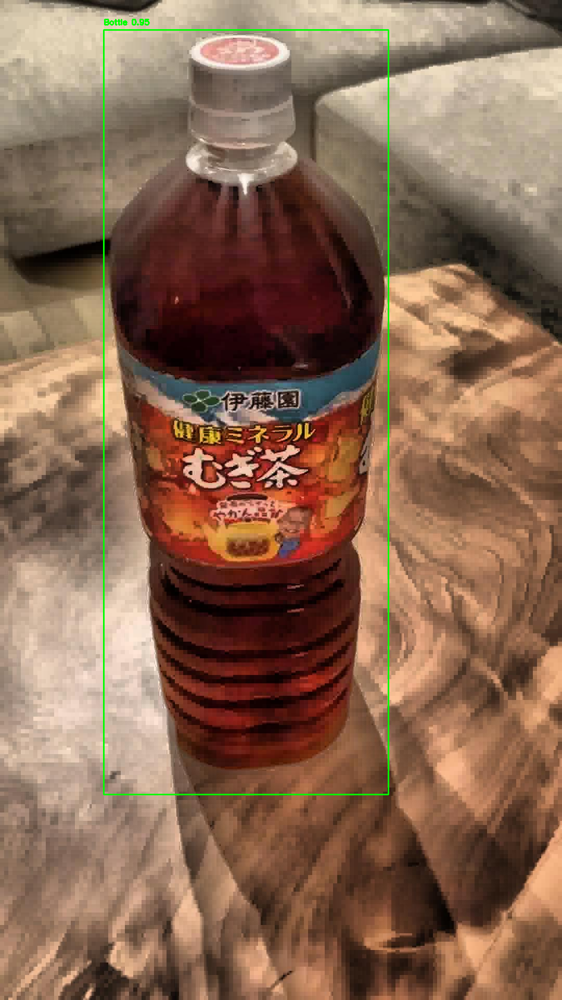

 90%|█████████ | 18/20 [00:15<00:01,  1.04it/s]

Output saved to: output_0024_jpg.rf.64464243965365d6dd83848ef8c2f0a6.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/bottle_10_jpg.rf.ae1669626b6dc38533c7106f8661e2d0.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=960, height=1280
Filtered Detections (Confidence > 0.5): 18
Detection: {'x': 527.2730827331543, 'y': 561.1302947998047, 'w': 109.00640487670898, 'h': 379.86888885498047, 'confidence': 0.8521664, 'class_id': 0}
Detection: {'x': 526.1492729187012, 'y': 560.5074691772461, 'w': 108.02862882614136, 'h': 380.21106719970703, 'confidence': 0.7528403, 'class_id': 0}
Detection: {'x': 525.5679702758789, 'y': 560.8693313598633, 'w': 109.30464506149292, 'h': 383.9175033569336, 'confidence': 0.8296795, 'class_id': 0}
Detection: {'x': 526.4551162719727, 'y': 560.2131271362305, 'w': 110.20922899246216, 'h': 384.5124816894531, 'confidence': 0.83139896, 'class_id': 0}
Detection: {'x': 526.1777114868164, 'y': 559.5987701416016, 'w': 111.20248

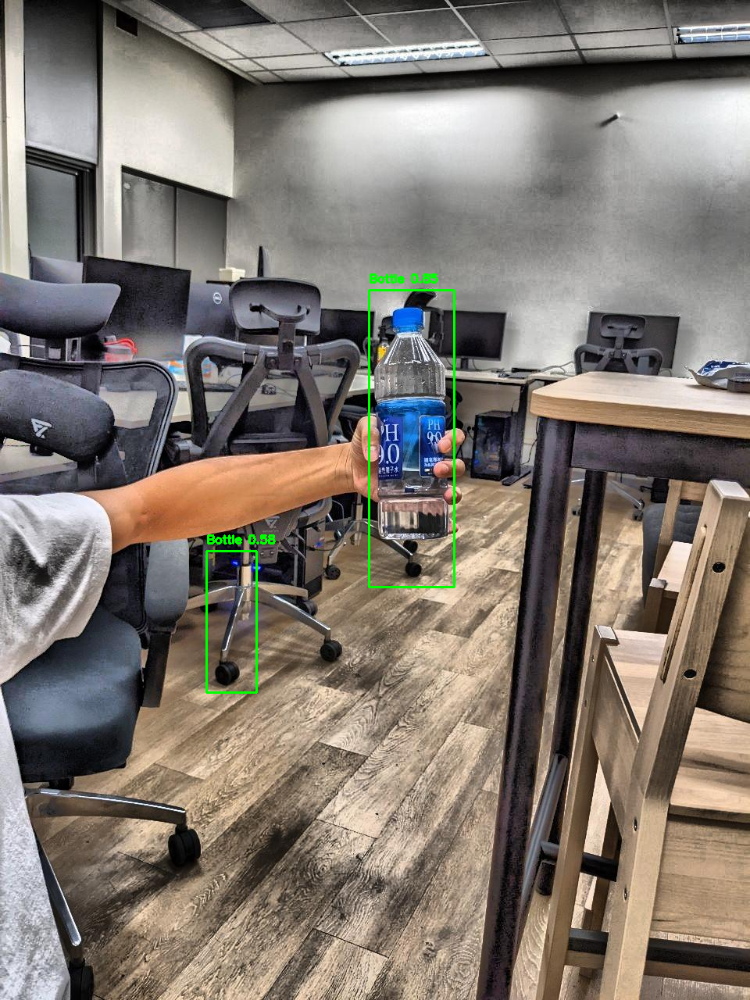

 95%|█████████▌| 19/20 [00:16<00:01,  1.10s/it]

Output saved to: output_bottle_10_jpg.rf.ae1669626b6dc38533c7106f8661e2d0.jpg
Processing Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/2020-02-04-05_33_01-187108_jpg.rf.7bad381667f146db96d0e28201cf2c1a.jpg
Raw Predictions Shape: (1, 6300, 6)
Image Dimensions: width=640, height=640
Filtered Detections (Confidence > 0.5): 12
Detection: {'x': 300.4673385620117, 'y': 261.1502456665039, 'w': 209.08580780029297, 'h': 510.177001953125, 'confidence': 0.8927812, 'class_id': 0}
Detection: {'x': 303.1316375732422, 'y': 264.05256271362305, 'w': 213.94136428833008, 'h': 469.2679977416992, 'confidence': 0.5075309, 'class_id': 0}
Detection: {'x': 306.07091903686523, 'y': 262.68163681030273, 'w': 216.0848617553711, 'h': 511.8855667114258, 'confidence': 0.935707, 'class_id': 0}
Detection: {'x': 303.7850761413574, 'y': 259.04077529907227, 'w': 218.99444580078125, 'h': 511.2399673461914, 'confidence': 0.9379516, 'class_id': 0}
Detection: {'x': 303.7144660949707, 'y': 259.2598152160

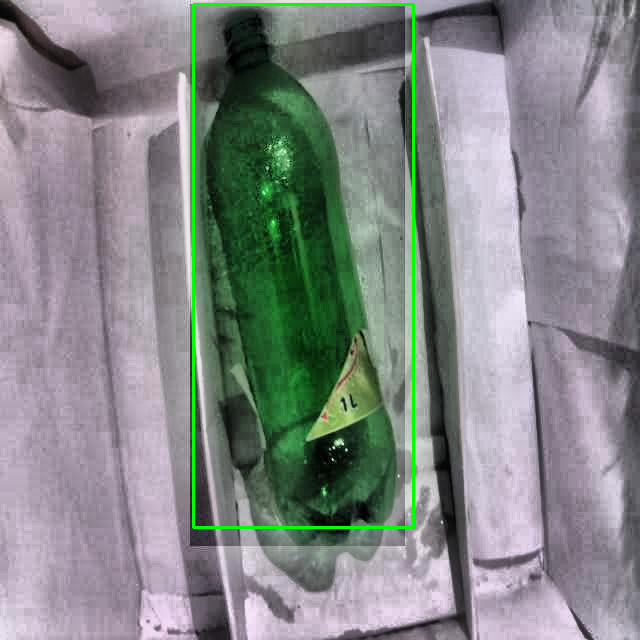

100%|██████████| 20/20 [00:17<00:00,  1.14it/s]

Output saved to: output_2020-02-04-05_33_01-187108_jpg.rf.7bad381667f146db96d0e28201cf2c1a.jpg


In [4]:
import tensorflow as tf
import numpy as np
import cv2
import os
from tqdm import tqdm
from google.colab.patches import cv2_imshow
tflite_model_file = '/content/best-fp16.tflite'
interpreter = tf.lite.Interpreter(model_path=tflite_model_file)
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Output Details:", output_details)
input_index = input_details[0]["index"]
def preprocess_image(image_path, input_size=320):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (input_size, input_size))
    img = img / 255.0
    img = np.expand_dims(img, axis=0).astype(np.float32)
    return img
CONFIDENCE_THRESHOLD = 0.5
def non_max_suppression(detections, iou_threshold=0.4):
    if not detections:
        return []
    boxes = np.array([[d['x'], d['y'], d['w'], d['h']] for d in detections])
    confidences = np.array([d['confidence'] for d in detections])
    nms_boxes = [
        [x - w / 2, y - h / 2, w, h] for x, y, w, h in boxes
    ]
    indices = cv2.dnn.NMSBoxes(
        nms_boxes, confidences.tolist(), CONFIDENCE_THRESHOLD, iou_threshold
    )
    if len(indices) == 0:
        return []
    indices = indices.flatten()
    return [detections[i] for i in indices]
test_dir = '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images'
test_images = [os.path.join(test_dir, img) for img in os.listdir(test_dir) if img.endswith(('.jpg', '.png'))]
num_images_to_sample = min(20, len(test_images))
sampled_images = test_images[:num_images_to_sample]
for img_path in tqdm(sampled_images):
    print(f"Processing Image: {img_path}")
    input_data = preprocess_image(img_path)
    interpreter.set_tensor(input_index, input_data)
    interpreter.invoke()
    predictions = interpreter.get_tensor(output_details[0]["index"])
    print(f"Raw Predictions Shape: {predictions.shape}")
    img = cv2.imread(img_path)
    h_img, w_img, _ = img.shape
    print(f"Image Dimensions: width={w_img}, height={h_img}")
    detections = [
        {
         "x": prediction[0] * w_img,
         "y": prediction[1] * h_img,
         "w": prediction[2] * w_img,
         "h": prediction[3] * h_img,
         "confidence": prediction[4],
         "class_id": int(prediction[5]),}
        for prediction in predictions[0]
        if prediction[4] > CONFIDENCE_THRESHOLD
    ]
    print(f"Filtered Detections (Confidence > {CONFIDENCE_THRESHOLD}): {len(detections)}")
    for det in detections:
        print(f"Detection: {det}")
    nms_detections = non_max_suppression(detections, iou_threshold=0.4)
    print(f"Detections After NMS: {len(nms_detections)}")
    for det in nms_detections:
        print(f"NMS Detection: {det}")
    bottle_count = 0
    for detection in nms_detections:
        x, y, w, h, confidence, class_id = (
            detection["x"],
            detection["y"],
            detection["w"],
            detection["h"],
            detection["confidence"],
            detection["class_id"],
        )
        if class_id == 0:
            bottle_count += 1
            xmin, xmax = int(x - w / 2), int(x + w / 2)
            ymin, ymax = int(y - h / 2), int(y + h / 2)
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            label = f"Bottle {confidence:.2f}"
            cv2.putText(
                img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2
            )
    if not nms_detections:
        print(f"No detections found for image: {img_path}")
    else:
        print(f"Bottles detected in image: {bottle_count}")
    cv2_imshow(img)
    output_image_path = f"output_{os.path.basename(img_path)}"
    cv2.imwrite(output_image_path, img)
    print(f"Output saved to: {output_image_path}")
    print("=" * 50)


In [ ]:
import tensorflow as tf
import os
import numpy as np
import cv2

# Paths
image_dir = "/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/"
output_model_path = "/content/yolov5/runs/train/fine_tune/weights/best-int8_ipuint8.tflite"

# Function to load and resize images
def load_and_resize_images(image_dir, target_size=(320, 320)):
    image_paths = [os.path.join(image_dir, fname) for fname in os.listdir(image_dir) if fname.endswith(('.jpg', '.jpeg', '.png'))]

    for image_path in image_paths:
        img = cv2.imread(image_path)  # Read the image using OpenCV
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR (default in OpenCV) to RGB
        img = cv2.resize(img, target_size)  # Resize using Lanczos interpolation
        img = np.expand_dims(img, axis=0)  # Add batch dimension (1, 640, 640, 3)
        img = img.astype(np.float32)  # Convert to float32
        img /= 255.0  # Normalize to [0, 1]
        yield img

# Load the FP16 model
converter = tf.lite.TFLiteConverter.from_saved_model("/content/yolov5/runs/train/fine_tune/weights/best_saved_model")  # Ensure it's the saved model path
def representative_dataset_gen():
    for image in load_and_resize_images(image_dir):
        yield [image]
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.representative_dataset = representative_dataset_gen
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
converter.inference_input_type = tf.uint8
converter.inference_output_type = tf.uint8
int8_model = converter.convert()
with open(output_model_path, "wb") as f:
    f.write(int8_model)
print(f"INT8 model saved to: {output_model_path}")

INT8 model saved to: /content/yolov5/runs/train/fine_tune/weights/best-int8_ipuint8.tflite


Output Details: [{'name': 'PartitionedCall:0', 'index': 408, 'shape': array([   1, 6300,    6], dtype=int32), 'shape_signature': array([   1, 6300,    6], dtype=int32), 'dtype': <class 'numpy.uint8'>, 'quantization': (0.007388690486550331, 2), 'quantization_parameters': {'scales': array([0.00738869], dtype=float32), 'zero_points': array([2], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]
Sampled Images: ['/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0225092510_jpg.rf.9a7fa4a2820b7cd216d066bc1f4a12ad.jpg', '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/2020-02-04-05_03_31-281206_jpg.rf.78773c1da2b486ee0123dc00244583e4.jpg', '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle08_jpg.rf.452db11b41d26f2eb5dc61bc8f966397.jpg', '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0225085331_jpg.rf.f0221b44a7cae9b4e86bb31c8e44d150.jpg', '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/imag

  0%|          | 0/12 [00:00<?, ?it/s]

Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6   2   2   2 136]
  [  2   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  [0.         0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (640, 640, 3)
Filtered detections (confidence > 0.5): [{'x': 160.7779049873352, 'y': 321.5558099746704, 'w': 211.20000000000002, 'h': 447.35999999999996, 'confidence': 0.7462577391415834, 'class_id': 0}, {'x': 160.7779049873352, 'y': 321.5558099746704, 'w': 211.20000000000002, 'h': 447.35999999999996, 'confidence': 0.9161976203322411, 'cla

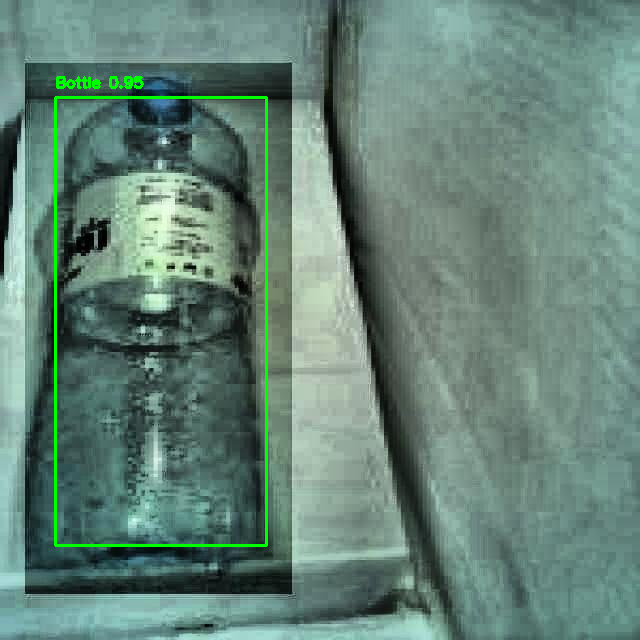

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0225092510_jpg.rf.9a7fa4a2820b7cd216d066bc1f4a12ad.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11  13   2 136]
  [  6   6   2   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [120 135   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.0812756  0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.98269583 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (600, 800, 3)
Filtered detections (confidence > 0.5): [{'x': 449.23238158226013, 'y': 301.4585718512535, 'w': 264.0, 'h': 607.3503579944372, 'confidence': 0.7979785725474358, 'class_id': 0}, {'x'

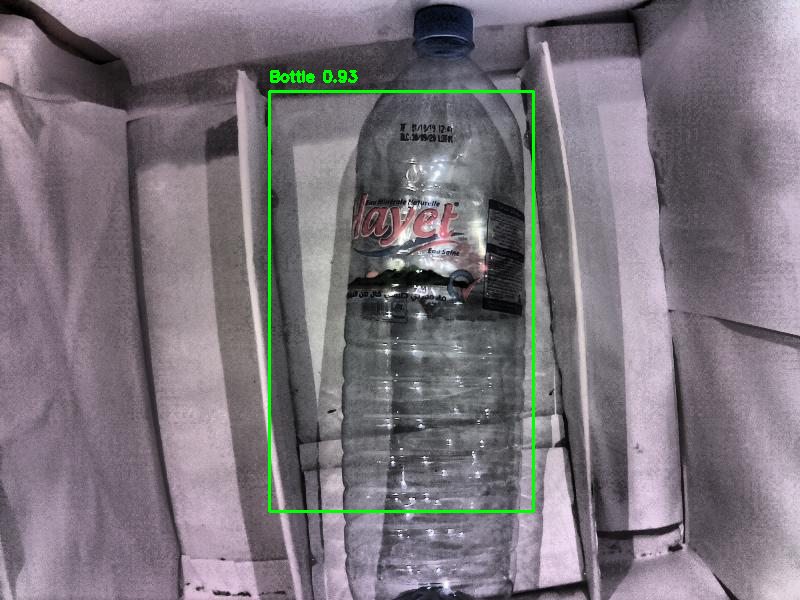

 17%|█▋        | 2/12 [00:01<00:05,  1.98it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/2020-02-04-05_03_31-281206_jpg.rf.78773c1da2b486ee0123dc00244583e4.jpg - Bottles detected: 1
Raw predictions: [[[  6   2  11   2   2 136]
  [  6   6  16   2   2 136]
  [  2   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [135 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.         0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.10344167 0.         0.         0.99008453]
  [0.         0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (640, 640, 3)
Filtered detections (confidence > 0.5): [{'x': 439.7748577594757, 'y': 278.9969527721405, 'w': 211.20000000000002, 'h': 447.35999999999996, 'confidence': 0.568929167

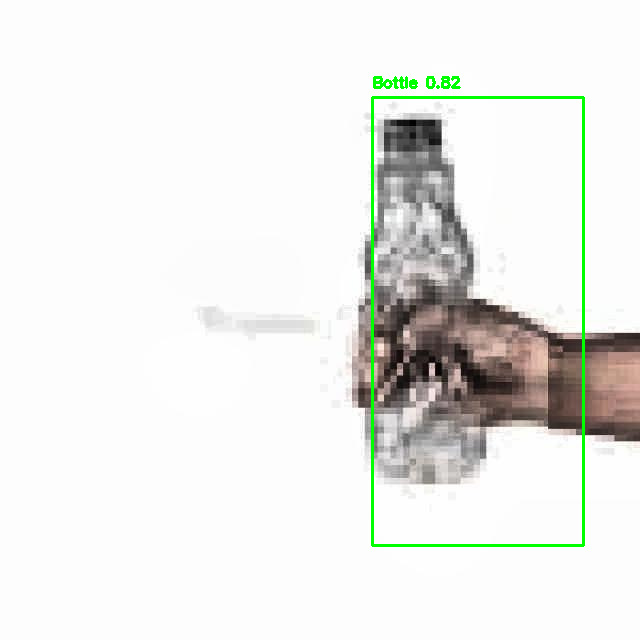

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle08_jpg.rf.452db11b41d26f2eb5dc61bc8f966397.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   2   2   2   2 136]
  [  2   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.         0.         0.         0.         0.99008453]
  [0.         0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (200, 150, 3)
Filtered detections (confidence > 0.5): [{'x': 46.548750065267086, 'y': 100.4861906170845, 'w': 140.7545537687838, 'h': 139.79999999999998, 'confidence': 0.69453690573

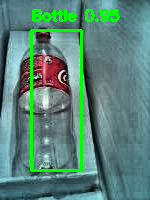

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0225085331_jpg.rf.f0221b44a7cae9b4e86bb31c8e44d150.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6   2   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (640, 640, 3)
Filtered detections (confidence > 0.5): [{'x': 321.5558099746704, 'y': 321.5558099746704, 'w': 211.20000000000002, 'h': 447.35999999999996, 'confidence': 0.9161976203322411, 'class_

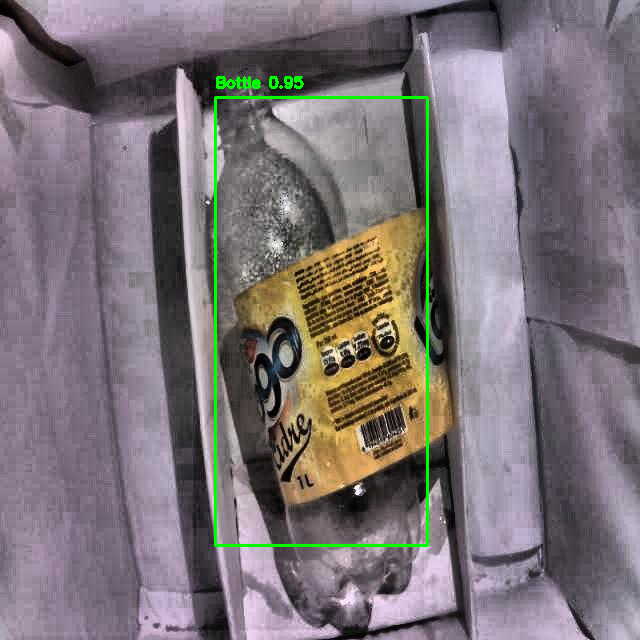

 42%|████▏     | 5/12 [00:02<00:03,  2.20it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/2020-02-04-05_34_52-667424_jpg.rf.7c4bcca7a47b10e088d97f3811e69c37.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6  16   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [135 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.10344167 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (225, 225, 3)
Filtered detections (confidence > 0.5): [{'x': 169.5704466663301, 'y': 98.08486620895565, 'w': 106.39714300632477, 'h': 219.44410745054483, 'confidence': 0.820144644

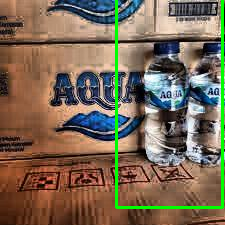

 50%|█████     | 6/12 [00:03<00:03,  1.83it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-2024-04-11T000613-679_jpeg.rf.0f9168b06f6bfefba71ee9b95f381ab7.jpg - Bottles detected: 1
Raw predictions: [[[  6   2  11   2   2 136]
  [  6   2  16   2   2 136]
  [  2   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.         0.06649821 0.         0.         0.99008453]
  [0.02955476 0.         0.10344167 0.         0.         0.99008453]
  [0.         0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (1920, 1080, 3)
Filtered detections (confidence > 0.5): [{'x': 470.8073578029871, 'y': 723.5005724430084, 'w': 1013.4327871352434, 'h': 1342.08, 'confidence': 0.886642858386039

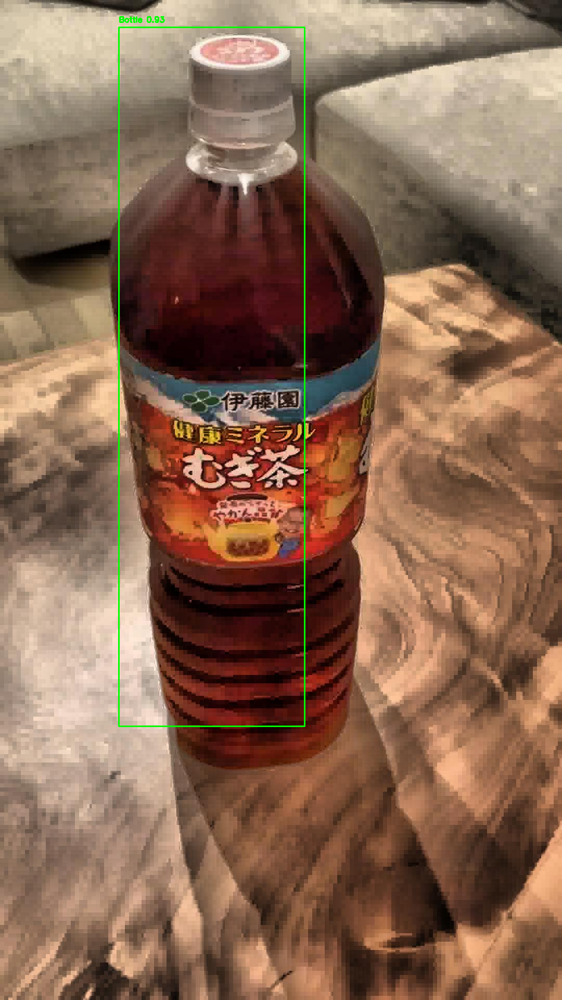

 58%|█████▊    | 7/12 [00:03<00:02,  2.14it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/0024_jpg.rf.64464243965365d6dd83848ef8c2f0a6.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6   2   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (1000, 585, 3)
Filtered detections (confidence > 0.5): [{'x': 293.9221075549722, 'y': 502.4309530854225, 'w': 193.05, 'h': 699.0, 'confidence': 0.8349220249801874, 'class_id': 0}, {'x': 293.92210755497

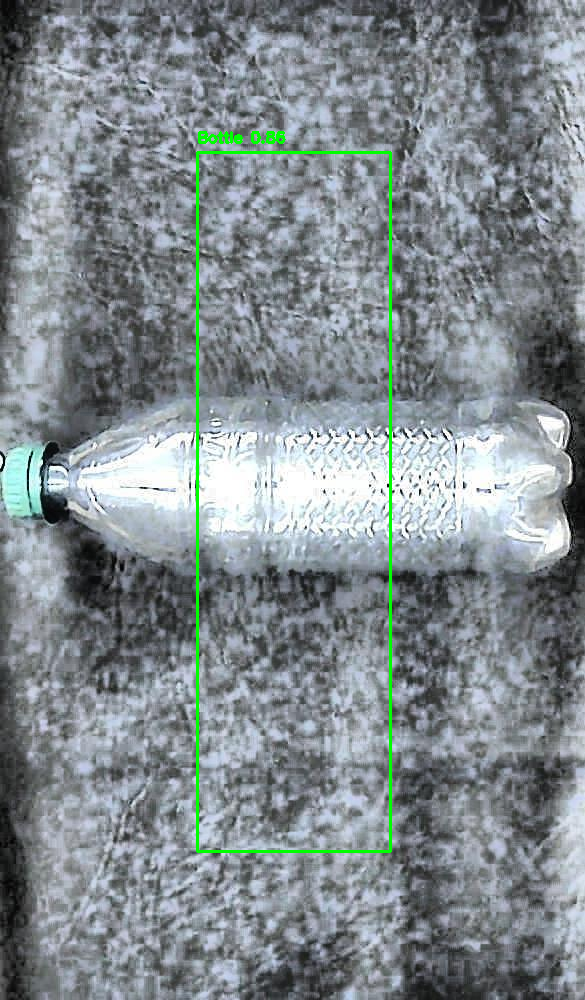

 67%|██████▋   | 8/12 [00:04<00:02,  1.88it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/cropped_pb_160_jpg.rf.b83b35a3f4e078c5e64f431048598d6c.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6  16   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [135 120   2   2   2 136]
  [120 120   2   2   2 136]
  [135 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.10344167 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (640, 640, 3)
Filtered detections (confidence > 0.5): [{'x': 321.5558099746704, 'y': 321.5558099746704, 'w': 633.6540961265564, 'h': 453.96114349365234, 'confidence': 0.9088089298456907, 'cla

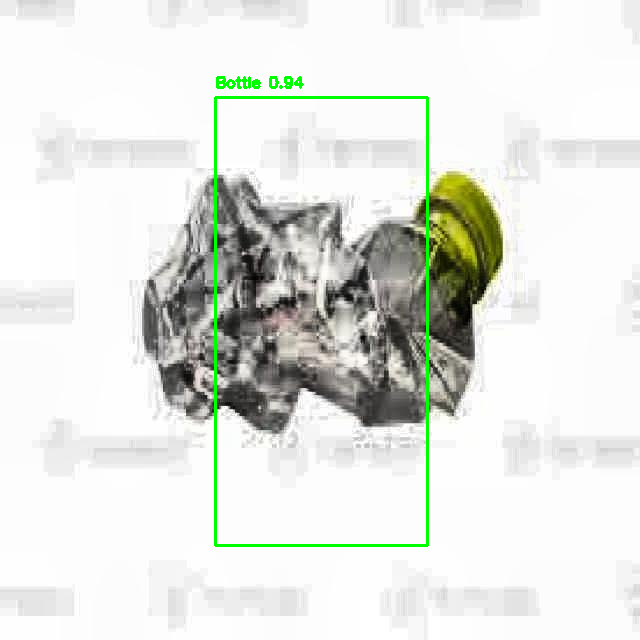

 75%|███████▌  | 9/12 [00:04<00:01,  1.73it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle70_jpg.rf.5b9a5df6e6d782152eef5cbe276e8e55.jpg - Bottles detected: 1
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6  16   2   2 136]
  [  2   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [135 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.10344167 0.         0.         0.99008453]
  [0.         0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (185, 272, 3)
Filtered detections (confidence > 0.5): [{'x': 136.66121923923492, 'y': 92.94972632080317, 'w': 89.76, 'h': 129.315, 'confidence': 0.9014202393591404, 'class_id': 0}, 

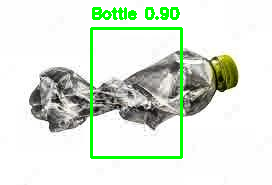

 83%|████████▎ | 10/12 [00:05<00:01,  1.68it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/crushed_plastic_bottle66_jpg.rf.55c3038bc5bc347a6381b10eda8f7cc5.jpg - Bottles detected: 1
Raw predictions: [[[  6   2  11   2   2 136]
  [  6   2   2   2   2 136]
  [  2   2   2   2   2 136]
  ...
  [135 120   2   2   2 136]
  [135 120   2   2   2 136]
  [135 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.         0.06649821 0.         0.         0.99008453]
  [0.02955476 0.         0.         0.         0.         0.99008453]
  [0.         0.         0.         0.         0.         0.99008453]
  ...
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]
  [0.98269583 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (225, 225, 3)
Filtered detections (confidence > 0.5): [{'x': 126.34660732001066, 'y': 98.08486620895565, 'w': 74.25, 'h': 219.44410745054483, 'confidence': 0.8349220249801874, 'clas

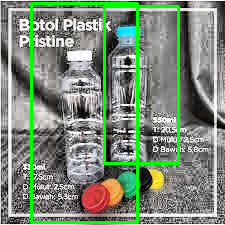

 92%|█████████▏| 11/12 [00:06<00:00,  1.45it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/images-2024-04-11T000628-281_jpeg.rf.d5104a5a54f764e339783f2b75beb108.jpg - Bottles detected: 2
Raw predictions: [[[  6   6  11   2   2 136]
  [  6   6   2   2   2 136]
  [  6   6   2   2   2 136]
  ...
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]
  [120 120   2   2   2 136]]]
Dequantized predictions: [[[0.02955476 0.02955476 0.06649821 0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  [0.02955476 0.02955476 0.         0.         0.         0.99008453]
  ...
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]
  [0.87186548 0.87186548 0.         0.         0.         0.99008453]]]
Image shape: (1000, 585, 3)
Filtered detections (confidence > 0.5): [{'x': 293.9221075549722, 'y': 435.93273870646954, 'w': 193.05, 'h': 699.0, 'confidence': 0.7462577391415834, 'class_id':

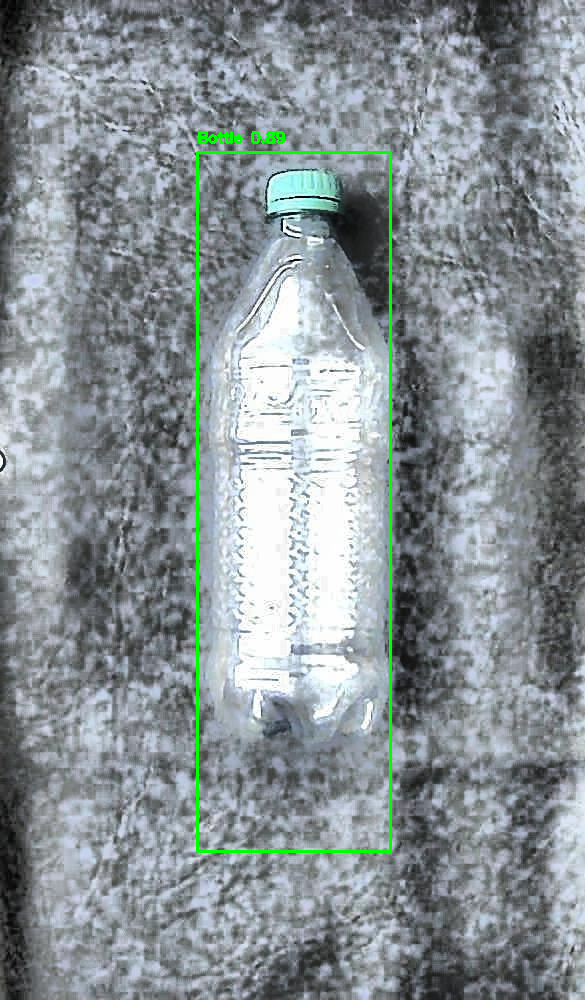

100%|██████████| 12/12 [00:07<00:00,  1.71it/s]

Image: /content/drive/MyDrive/YOLO_Project/BottleDataset/test/images/cropped_pb_248_jpg.rf.4db7b31bf434d225a586dbea4b213743.jpg - Bottles detected: 1


In [7]:
import tensorflow as tf
import numpy as np
import cv2
import os
from tqdm import tqdm
from google.colab.patches import cv2_imshow
import random

# Path to the TFLite model
tflite_model_file = '/content/best-int8_ipuint8.tflite'  # Your quantized TFLite model
interpreter = tf.lite.Interpreter(model_path=tflite_model_file)
interpreter.allocate_tensors()

# Get input and output tensor details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Output Details:", output_details)

input_index = input_details[0]["index"]
output_index = output_details[0]["index"]

# Input and output scales and zero points for quantization
input_scale, input_zero_point = input_details[0]['quantization']
output_scale, output_zero_point = output_details[0]['quantization']

# Define image preprocessing function
def preprocess_image(image_path, input_size=320):
    """
    Preprocess the input image for YOLOv5 TFLite model.
    - Resize to the model's input size.
    - Normalize pixel values to [0, 1].
    - Quantize to uint8.
    """
    img = cv2.imread(image_path)
    img = cv2.resize(img, (input_size, input_size))
    img = img / 255.0  # Normalize to [0, 1]
    img = np.expand_dims(img, axis=0).astype(np.float32)  # Add batch dimension

    # Quantize the input if the model requires uint8
    if input_details[0]['dtype'] == np.uint8:
        img = img / input_scale + input_zero_point
        img = img.astype(np.uint8)

    return img

# Detection threshold (confidence score to consider a detection valid)
CONFIDENCE_THRESHOLD = 0.5

# Non-Maximum Suppression (NMS)
def non_max_suppression(detections, iou_threshold=0.3):
    """
    Apply Non-Maximum Suppression (NMS) to filter overlapping detections.
    :param detections: List of detections with bounding boxes and confidence scores.
    :param iou_threshold: IoU threshold to suppress overlapping boxes.
    :return: Filtered detections after applying NMS.
    """
    if not detections:
        return []

    boxes = np.array([[d['x'], d['y'], d['w'], d['h']] for d in detections])
    confidences = np.array([d['confidence'] for d in detections])

    # Convert boxes to the format required by cv2.dnn.NMSBoxes
    nms_boxes = [
        [x - w / 2, y - h / 2, w, h] for x, y, w, h in boxes
    ]  # Convert from center to top-left x, y, width, height

    indices = cv2.dnn.NMSBoxes(
        nms_boxes, confidences.tolist(), CONFIDENCE_THRESHOLD, iou_threshold
    )

    if len(indices) == 0:
        return []

    indices = indices.flatten()
    return [detections[i] for i in indices]

# Define the test dataset path
test_dir = '/content/drive/MyDrive/YOLO_Project/BottleDataset/test/images'

# Get the list of test images
test_images = [os.path.join(test_dir, img) for img in os.listdir(test_dir) if img.endswith(('.jpg', '.png', '.jpeg'))]

# Randomly shuffle the images
random.shuffle(test_images)

# Limit the number of images to sample
num_images_to_sample = min(12, len(test_images))  # Sample up to 5 images
sampled_images = test_images[:num_images_to_sample]

# Print the sampled images
print("Sampled Images:", sampled_images)

for img_path in tqdm(sampled_images):
    input_data = preprocess_image(img_path)
    interpreter.set_tensor(input_index, input_data)  # Set preprocessed input
    interpreter.invoke()  # Run inference

    # Retrieve predictions
    predictions = interpreter.get_tensor(output_index)  # Shape: [1, 6375, 6]

    # Debugging: Print raw predictions before dequantization
    print("Raw predictions:", predictions)

    # Dequantize predictions if the model uses int8 output
    if output_details[0]['dtype'] == np.uint8:
        predictions = (predictions - output_zero_point) * output_scale

    # Debugging: Print dequantized predictions
    print("Dequantized predictions:", predictions)

    # Load the image for visualization
    img = cv2.imread(img_path)
    h_img, w_img, _ = img.shape

    print(f"Image shape: {img.shape}")
    threshold = 0.0001  # Define a threshold for small values
    min_width = 0.33  # Default minimum width in pixels
    min_height = 0.699

    # Filter predictions by confidence and retain those above the threshold
    detections = [


        {

            "x": prediction[0] * w_img,
            "y": prediction[1] * h_img,
            "w": prediction[2] * w_img,
            "h": prediction[3] * h_img,
            "confidence": prediction[4],
            "class_id": int(prediction[5]),
        }
        for prediction in predictions[0]
        if prediction[4] > CONFIDENCE_THRESHOLD  # Only consider detections with high confidence
    ]

    # Debugging: Print filtered detections
    print("Filtered detections (confidence > 0.5):", detections)

    # Apply Non-Maximum Suppression
    detections = non_max_suppression(detections, iou_threshold=0.3)

    # Debugging: Print detections after NMS
    print("Detections after NMS:", detections)

    # For each detected object, draw a bounding box
    bottle_count = 0
    for detection in detections:
        x, y, w, h, confidence, class_id = (
            detection["x"],
            detection["y"],
            detection["w"],
            detection["h"],
            detection["confidence"],
            detection["class_id"],
        )
        print(f"x:{x}, y:{y}, w:{w}, h:{h}, conf:{confidence}, class:{class_id}")
        if class_id == 0:  # Assuming class 0 corresponds to 'bottle'
            bottle_count += 1

            # Convert normalized coordinates to pixel values
            xmin, xmax = int(x - w / 2), int(x + w / 2)
            ymin, ymax = int(y - h / 2), int(y + h / 2)

            # Debugging: Print the coordinates of bounding boxes
            print(f"Bounding box coordinates: ({xmin}, {ymin}) to ({xmax}, {ymax})")

            # Draw bounding box
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)  # Green box
            label = f"Bottle {confidence:.2f}"
            cv2.putText(
                img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2
            )

    # Display the image with bounding boxes
    cv2_imshow(img)
    output_image_path = f"output_{os.path.basename(img_path)}"
    cv2.imwrite(output_image_path, img)  # Save the image with bounding boxes

    print(f"Image: {img_path} - Bottles detected: {bottle_count}")


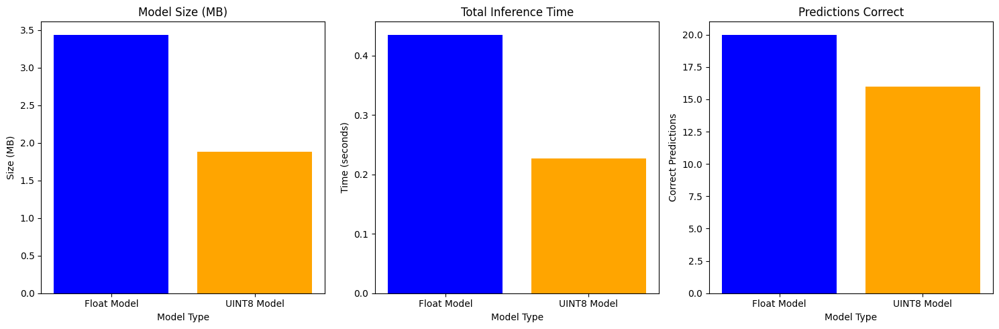

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data for the graphs
model_types = ['Float Model', 'UINT8 Model']
model_sizes = [3.44, 1.88]  # in MB
total_inference_times = [0.4353, 0.2268]  # in seconds
average_inference_times = [0.0218, 0.0128]  # in seconds
predictions_correct = [20, 16]  # correct predictions out of 20

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plotting Model Size
axes[0].bar(model_types, model_sizes, color=['blue', 'orange'])
axes[0].set_title("Model Size (MB)")
axes[0].set_ylabel("Size (MB)")
axes[0].set_xlabel("Model Type")

# Plotting Total Inference Time
axes[1].bar(model_types, total_inference_times, color=['blue', 'orange'])
axes[1].set_title("Total Inference Time")
axes[1].set_ylabel("Time (seconds)")
axes[1].set_xlabel("Model Type")

# Plotting Predictions Correct
axes[2].bar(model_types, predictions_correct, color=['blue', 'orange'])
axes[2].set_title("Predictions Correct")
axes[2].set_ylabel("Correct Predictions")
axes[2].set_xlabel("Model Type")

# Adjust layout for clarity
plt.tight_layout()
plt.show()
